## Assignment - COVID 19 Global Confirmed data, Explanatory Analysis
### Author: Shanshan Lin

This assignment takes the data sets, 'time_series_covid19_confirmed_global.csv' and 'time_series_covid19_deaths_global.csv', from the CSSEGISandData COVID-19 data source that is accessible on GitHub (URL: https://github.com/CSSEGISandData/COVID-19/tree/master/csse_covid_19_data/csse_covid_19_time_series). 

The two datasets contain the **cumulative** number of confirmed cases and deaths up till the recorded date in the 'Date' variable. The focus of this script is to perform explanatory analysis on the two datasets. Specifically, the following steps will be taken for the analysis:

    1. Convert and merge the datasets to a time series
    2. Seperating the dataset into two parts - Countries that contain state-level data, and Countries that do not.
    2. Perform data cleaning tasks on each of the two groups, which can include but not limited to subsetting, reformatting, normalizing and imputing data abnormalities.
    3. Visualizing data for the two groups using various types of plots to explore the relationship between variables.
    
The goal of the summary section at the end of this script is to:

    1. explain the purpose and structure of this dataset, and what has been done in this script to understand the data   
    2. highlight some significant relationships between variables in the data that are potential use cases for further analysis

### Preparation
Reading in the libraries and the input dataset:

In [1]:
# import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
# read in data
file_name = ['time_series_covid19_confirmed_global.csv', 'time_series_covid19_deaths_global.csv']
source_name = 'https://github.com/CSSEGISandData/COVID-19/raw/master/csse_covid_19_data/csse_covid_19_time_series/'

confirmed = pd.read_csv(source_name + file_name[0])
deaths = pd.read_csv(source_name + file_name[1])

### Data Cleaning
1. First, define a function that reformats the data and converts the date varible to datetime format for time series purposes. Then merge the two datasets into one.

In [3]:
def cleaning(df, type):
    df = df.drop_duplicates()
    df = pd.melt(df, id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], var_name = 'Date', value_name = type)
    
    df['Date'] = pd.to_datetime(df['Date'], infer_datetime_format=True)
    
    return df

In [4]:
# call the above function
confirmed = cleaning(confirmed, 'confirmed')
deaths = cleaning(deaths, 'deaths')

# merge the datasets
df = pd.merge(confirmed,deaths,on=['Province/State', 'Country/Region', 'Date', 'Lat', 'Long'])
df

,Province/State,Country/Region,Lat,Long,Date,confirmed,deaths
0,NaN,Afghanistan,33.939110,67.709953,2020-01-22,0,0
1,NaN,Albania,41.153300,20.168300,2020-01-22,0,0
2,NaN,Algeria,28.033900,1.659600,2020-01-22,0,0
3,NaN,Andorra,42.506300,1.521800,2020-01-22,0,0
4,NaN,Angola,-11.202700,17.873900,2020-01-22,0,0
...,...,...,...,...,...,...,...
210183,NaN,West Bank and Gaza,31.952200,35.233200,2022-02-07,578424,5166
210184,NaN,Winter Olympics 2022,39.904200,116.407400,2022-02-07,459,0
210185,NaN,Yemen,15.552727,48.516388,2022-02-07,11266,2028
210186,NaN,Zambia,-13.133897,27.849332,2022-02-07,307317,3933


Confirming that there are no missing values in the numerical column. If there is any, the loop would print out the problematic rows:

In [5]:
if df['confirmed'].isnull().values.any() == True or (df['deaths'].isnull().values.any()) == True:
    print(pd.merge(df[df['confirmed'].isnull()],df[df['deaths'].isnull()]))
else:
    print('No NAs exist')

No NAs exist


2. Subsetting data

Upon examining the dataset, the countries that do not have data for Province/State have the same latitude and longitude across all records, whereas the countries that have Province/State data contains longitude and latitude information for each province/state. Therefore, the data will be subset into two big groups for visualizations and analysis, 'State-level' - contains countries with at least one 'Province/State' that is not NA, and 'Country-level' - Contains countries with all NAs in Province/State. Please note that even if there is only one province/state data for a country, all records for this country would still fall under the State-Level group.

For the Country-level group, the countries will be split into 4 big regions, North-East, North-West, South-East, South-West, based on the 'long' and 'lat' columns in the dataset. Per definition, 'Lat' and 'Long' is 'Latitude' and 'Longitude', which are indicators of geographic locations on earth.


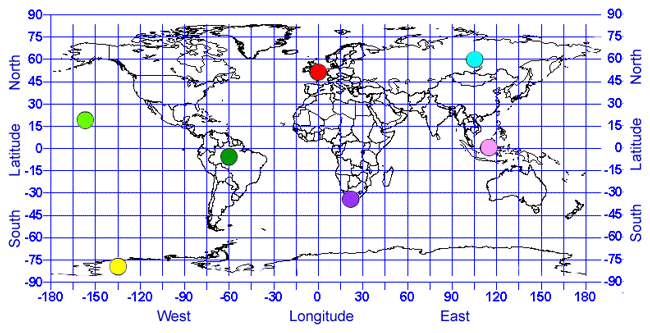

Image source: https://laulima.hawaii.edu/access/content/group/dbd544e4-dcdd-4631-b8ad-3304985e1be2/book/chapter_1/longitude.htm

In [6]:
# splitting dataset based on the presence of province/state data
contains_state = list(pd.unique(df[~df['Province/State'].isnull()]['Country/Region']))
state_df = df[df['Country/Region'].isin(contains_state)]
country_df = df[~df['Country/Region'].isin(contains_state)]

Splitting 'Country-level' - the countries that do not have state level data, and therefore have consistent longitute/latitude records, into four regions

In [7]:
# Splitting into four regions based on latitude and longtitude
NE = country_df[(country_df['Lat'] > 0) & (country_df['Long'] > 0)]
NW = country_df[(country_df['Lat'] > 0) & (country_df['Long'] < 0)]
SE = country_df[(country_df['Lat'] < 0) & (country_df['Long'] > 0)]
SW = country_df[(country_df['Lat'] < 0) & (country_df['Long'] < 0)]

Reformatting 'State-level' data - the countries that have state level data for visualizations, into seperate countries

In [8]:
state_df = state_df.drop(['Lat', 'Long'], axis=1) # dropping lat and long for state-level analysis
state_df["Province/State"].fillna("Unspecified", inplace = True) # setting 'NaNs' into 'unspecified'
countries = pd.unique(state_df['Country/Region']) # record a list of all countries that have state-level data

# merge the Country and state info into one column, so it appears as 'Country - State'
state_df_og = state_df.copy() # keep the original state_df
state_df["Country/Region"] = state_df["Country/Region"] + ' - ' + state_df["Province/State"] 


### Algorithms

Define a function that reformats data and generates visualizations:

In [9]:
def visuals(df, region):
    # reformatting
    df1 = pd.DataFrame(df.loc[:, ['Date', 'Country/Region','confirmed','deaths']]) # keeping country variable and 'confirmed'
    # group by country
    grouped_sum = df1.groupby(['Country/Region']).sum().sort_values(by=['confirmed'], ascending = False)
    grouped_sum['Country'] = grouped_sum.index
      
    # bar plot - cases
    sns.set(rc={'figure.figsize':(18,8)})
    plot1 = plt.figure(1)
    plot1 = sns.barplot(data=grouped_sum,  x='Country', y='confirmed')
    plot1.set_title("Global %s Regional - Covid cases from 2020 to 2022"%region)
    plot1.set_xlabel("Country names")
    plot1.yaxis.get_major_formatter().set_scientific(False)
    plot1.set_ylabel("No of covid cases")
    plot1.set_xticklabels(plot1.get_xticklabels(),rotation = 90)
    plt.show()

    # line chart - cases
    import plotly.express as px
    daily = df1[['Date','confirmed']].groupby(['Date']).sum().reset_index()
    plot2 = plt.figure(2)
    plot2 = px.line(daily, x="Date", y="confirmed", title='No of cases in Global %s region - Cumulative Daily'%region,
                    labels={"Confirmed": "Number of covid cases", "Date": "Reported date"})
    plot2.show()
    
    # pie chart - deaths
    df1['Date'] = pd.to_datetime(df1['Date']).dt.date
    df1['Date'] = df1['Date'].to_numpy().astype('datetime64[M]')
    plot3 = plt.figure(3)
    plot3 = px.pie(df1, values='deaths', names='Country/Region', title='Global %s regional case distribution'%region)
    plot3.show()
    
    # scatter plot - relationship between cases and deaths
    plot4 = plt.figure(4)
    plot4 = px.scatter(df1, x="confirmed", y="deaths", title="Relationship between number of cases and deaths, Global %s regional data"%region, labels={"confirmed": "Number of covid cases","deaths": "Number of covid deaths"},color='Country/Region')
    plot4.show()
    
    return df1

Defines another function for state-level data that uses the algorithms of the above function:

In [10]:
def country_state_visuals(df, country):
    df = state_df[state_df['Country/Region'].str.contains(country)]
    df["Country/Region"] = df["Country/Region"] + ' - ' + df["Province/State"]
    state_lvl_data = visuals(df, '%s by state'%country)

### Country-level data visualization and analysis:

#### Results for North-East countries (Countries that have Latitide > 0 and Longtitute > 0)

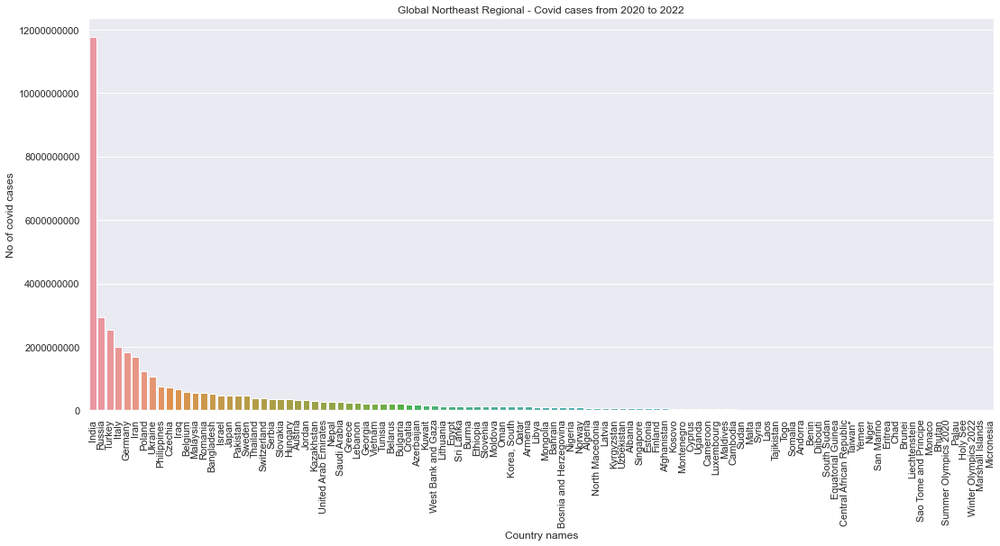

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

In [17]:
country_lvl_data= visuals(NE, 'Northeast')

According to the above plots, in the northeast global region, India has the leading number of COVID-19 cases and contributed to almost 25% of deaths in the region, and Russia as second highest due to the recent outbreak. The overall trend for global northeast experienced a rapid increase since January 2022, a potential cause of the surge could be the recent outbreak in India and Russia (and many other countried but less intense in numbers). 

The relationship between confirmed cases and deaths shows an overall positive correlation, however it varies by countries and medical situations - for example, Russia accumulated roughly 300k deaths when their accumulated confirmed cases was 10M, whereas India only had 150k deaths when their confirmed cases reached the 10M mark. Howver, the number of deaths and confirmed cases in India later quickly surged when the medical system was overloaded by the striking increase of COVID patients.

#### Results for North-West (Countries that have Latitide > 0 and Longtitute < 0)

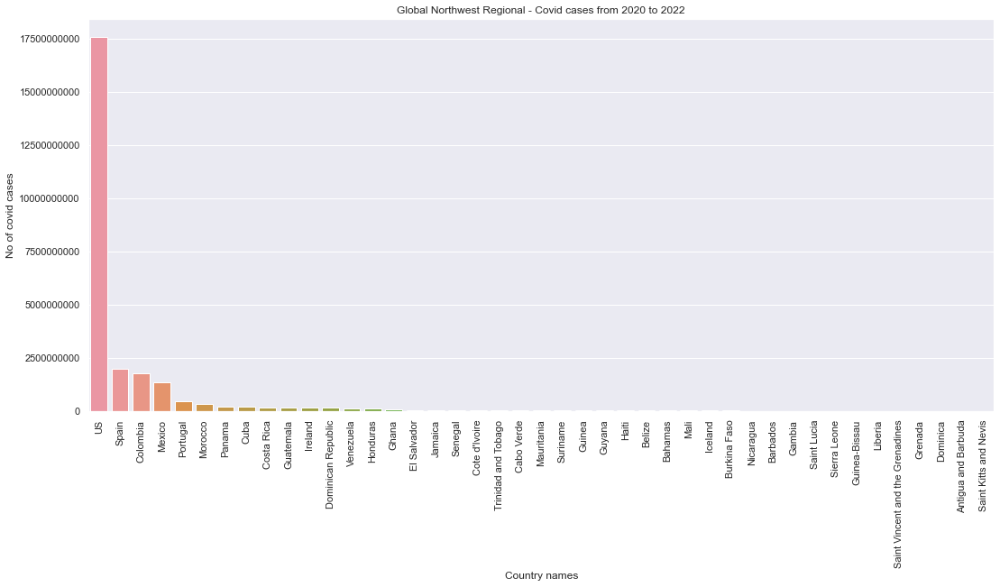

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

In [18]:
country_lvl_data= visuals(NW, 'Northwest')

According to the above plots, in the northwest global region, the US has the leading number of COVID-19 cases and contributed to 56.2% of deaths in the region, most likely caused by the ongoing outbreak within the country. 

The scatter plot again showed that the relationship between confirmed cases and deaths is heavily affected by the country's medical and social situations - Mexico, as a country that does not have a massive number of confirmed cases, has the highest fatality rate amongst all countries in the region. This is most likely due to their exhausted medical system and low testing/vaccination availability within the country.

#### Results for South-East (Countries that have Latitide < 0 and Longtitute > 0)

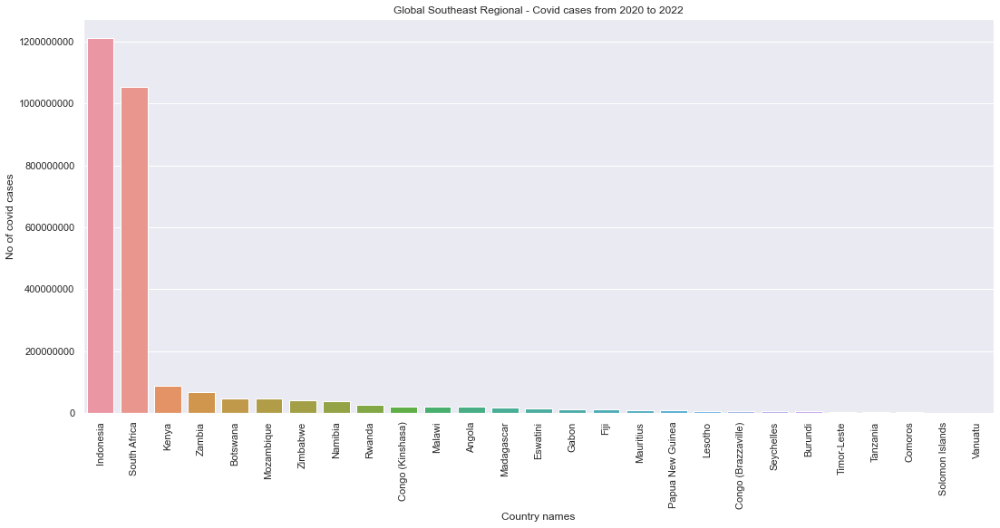

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

In [19]:
country_lvl_data = visuals(SE, 'Southeast')

According to the above plots, in the southwest global region, Indonesia and South Africa has the leading number of COVID-19 cases and all together contributed to 87.9% of deaths in the region. The two countries both shows positive correlations in the relationship between confirmed cases, with the other countries in the region showing poisitive correlations as well.

#### Results for South-West (Countries that have Latitide < 0 and Longtitute < 0)

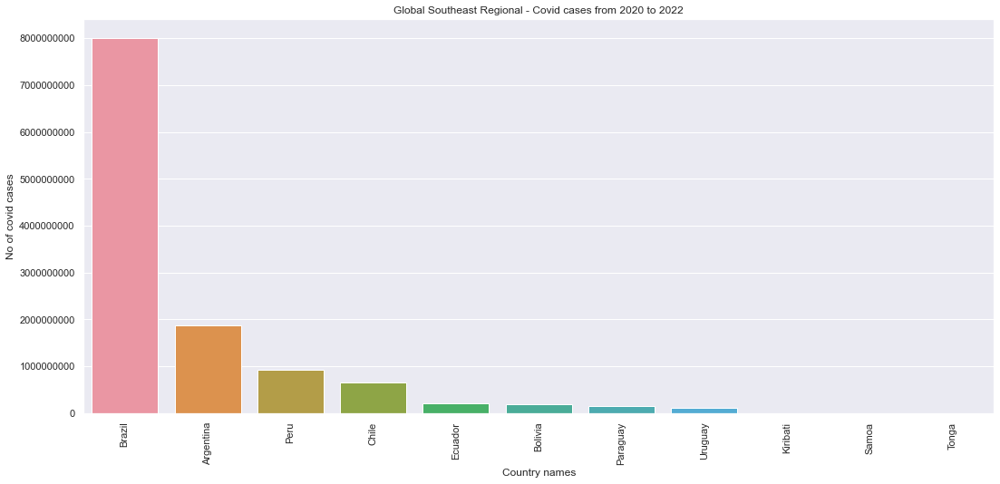

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

In [20]:
country_lvl_data = visuals(SW, 'Southeast')

According to the above plots, in the northwest global region, Brazil has the leading number of COVID-19 cases and contributed to 56.9% of deaths in the region. Even though there seems to be a surge in confirmed cases since January 2022, so far in this region, the number of deaths appears stable and not rapidly increasing.

### State-level data visualization and analysis
Plotting an Overall view of all countries in this group:

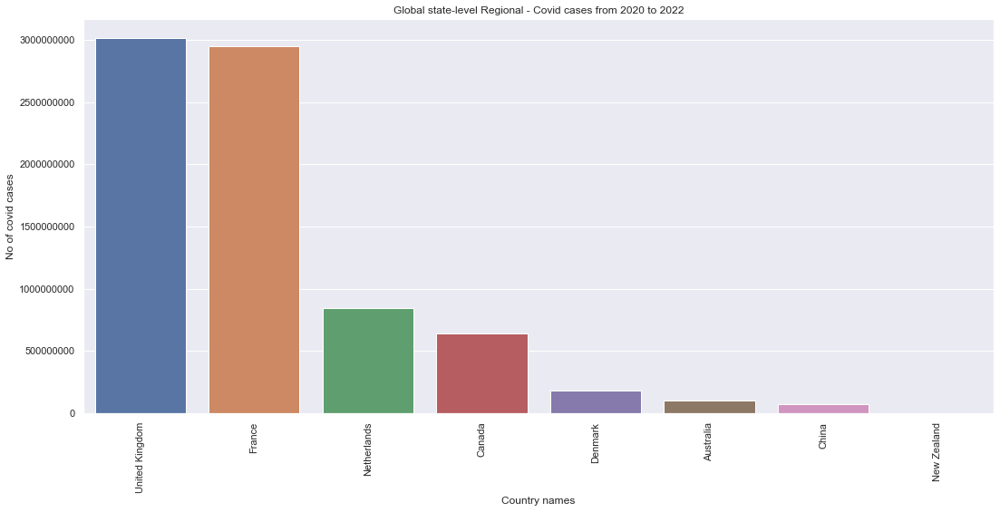

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

In [21]:
state_lvl_data = visuals(state_df_og, 'state-level')

The United Kingdom and France are two countries with the most confirmed cases in this group. Overall, the countries in this group have all experienced a rapid increase of cases and deaths in the beginning of the outbreak, and later the fatality rates stabalized. Even though overall the accumulated cases started increasing since January 2022 again, the fatality rate remains stable so far. From examining the countries, the stabalized death rate could be caused by the countries in this group being relatively developed countries with decent health care system and vaccination rate.

Generating visualizations for all states in each country individually:

Visualization results for Australia: 


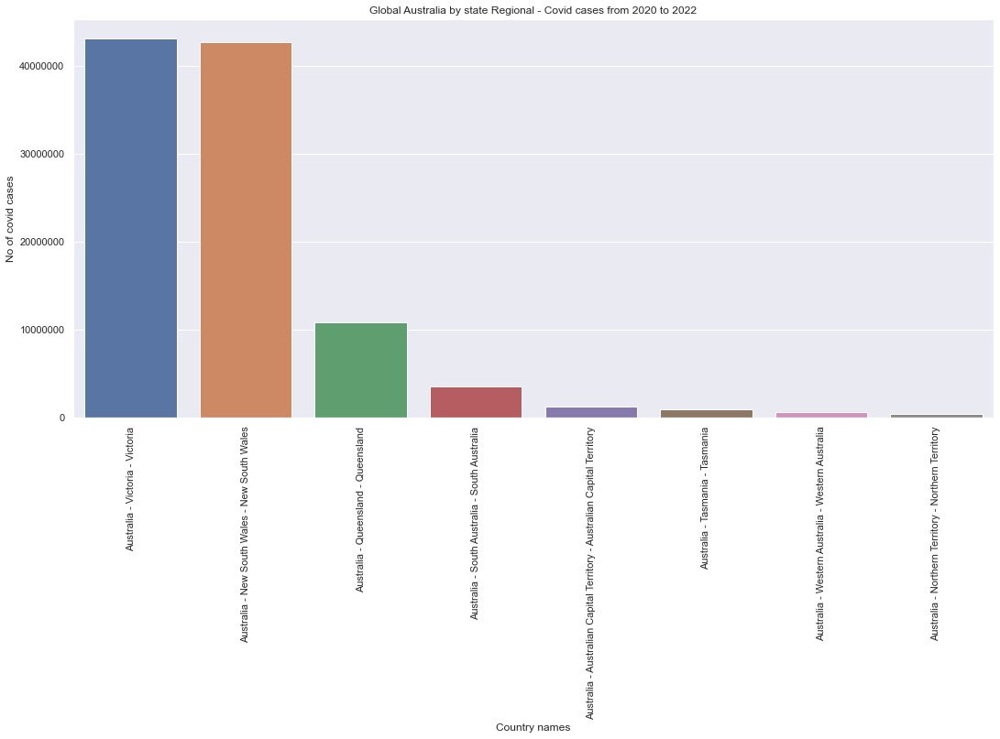

Visualization results for Canada: 


<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

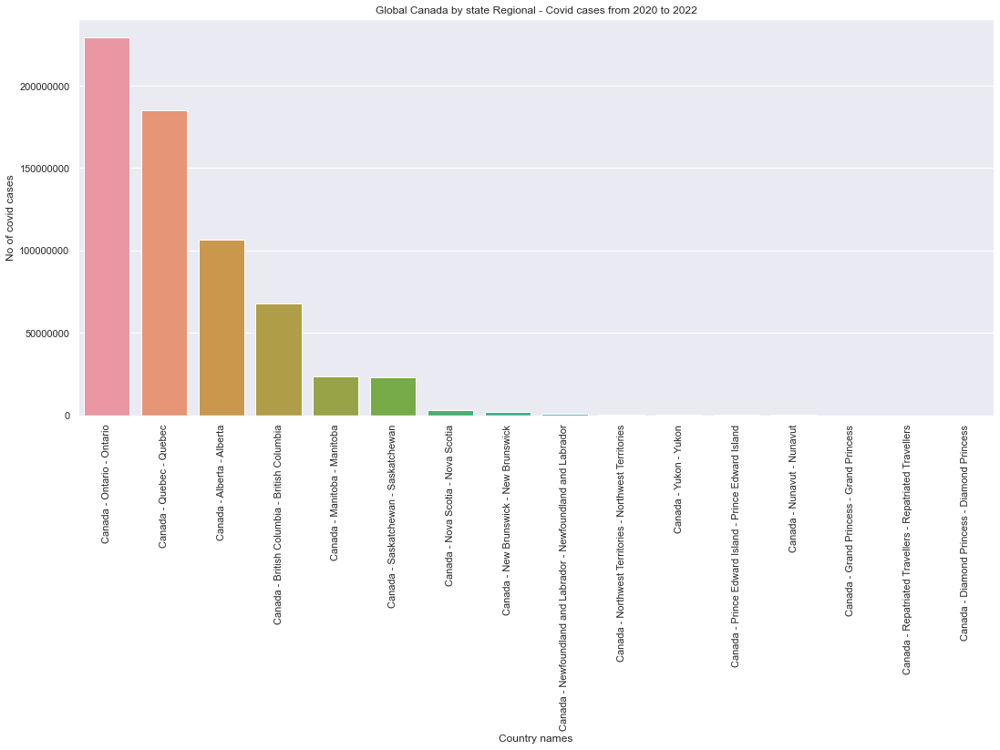

Visualization results for China: 


<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

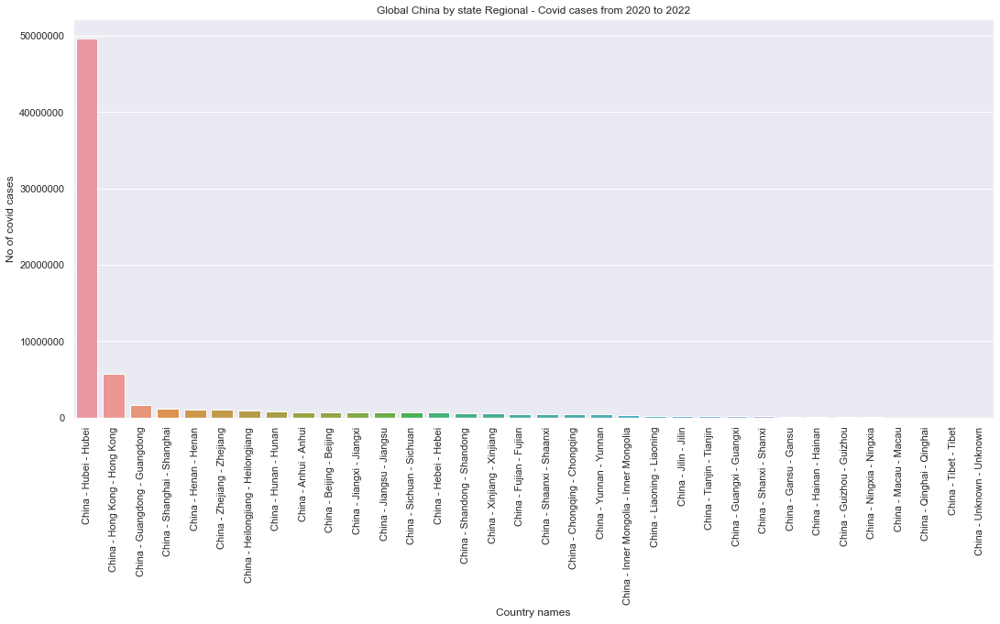

Visualization results for Denmark: 


<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

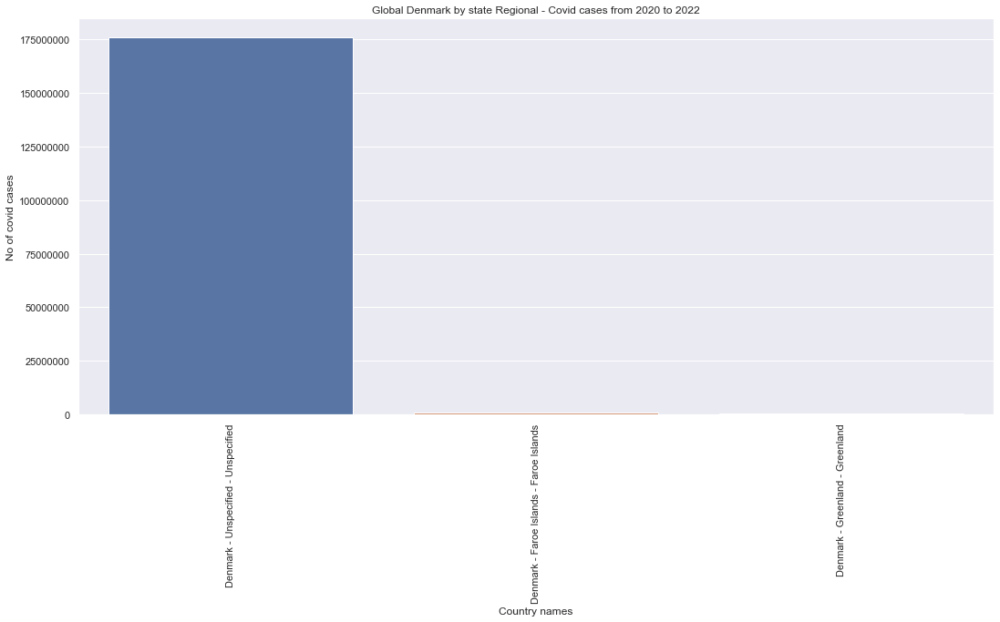

Visualization results for France: 


<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

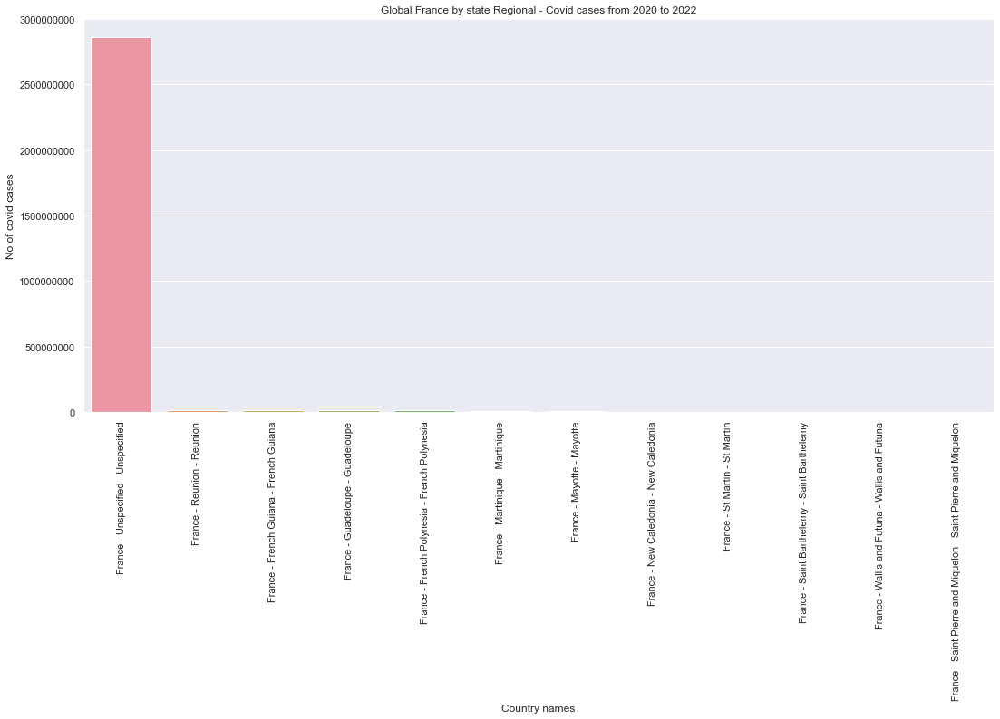

Visualization results for Netherlands: 


<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

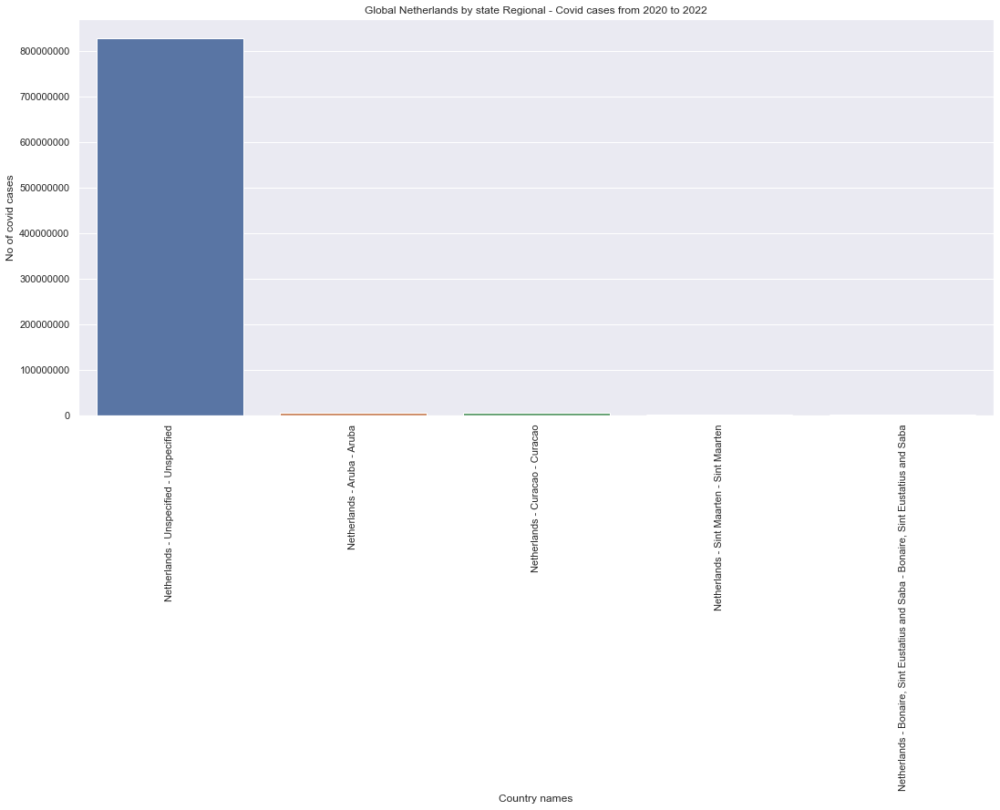

Visualization results for New Zealand: 


<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

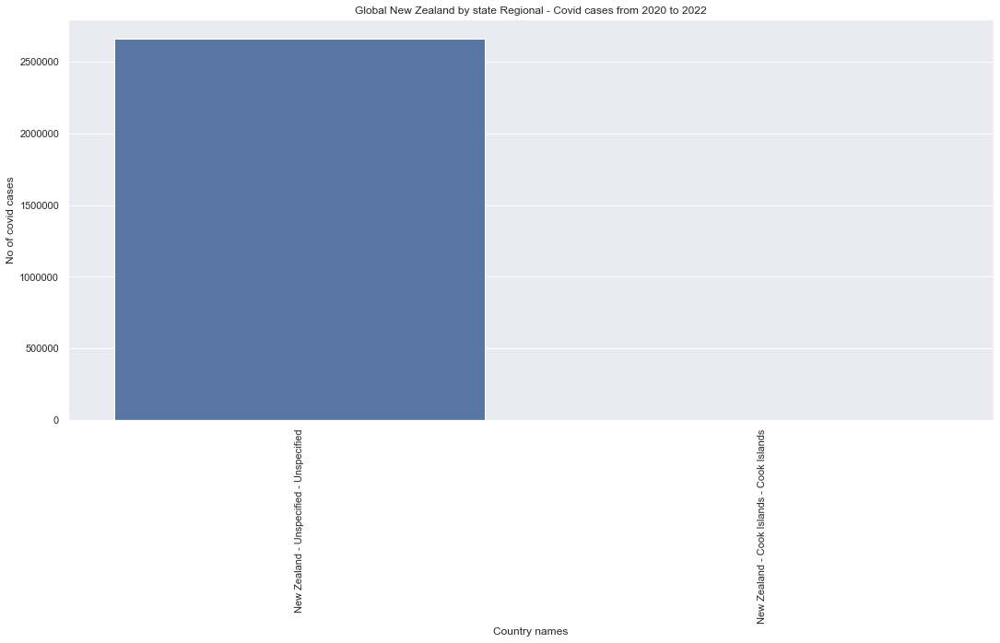

Visualization results for United Kingdom: 


<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

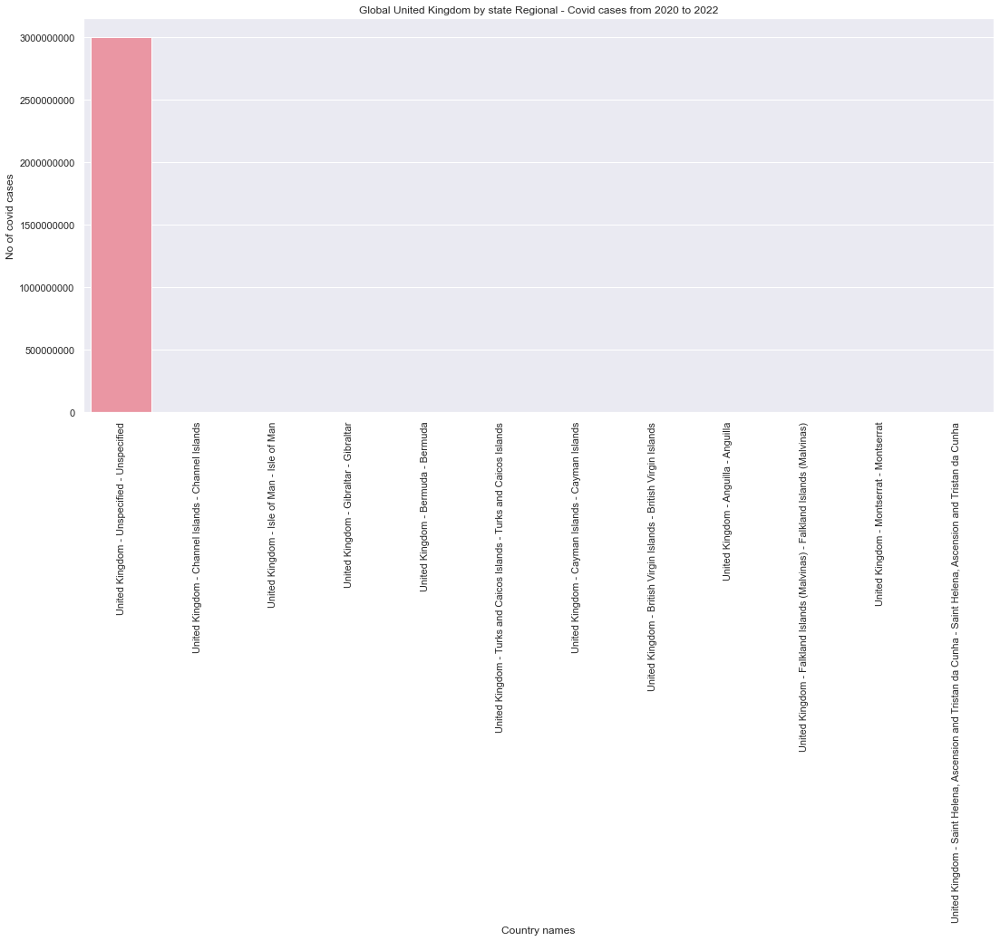

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

<Figure size 1296x576 with 0 Axes>

In [22]:
for country in countries:
    print('Visualization results for %s: '%country)
    country_state_visuals(state_df, country)


Among all the countries that contain state-level data, the United Kingdom and France have the most cumulative confirmed cases. Many countries only have data for one state and the rest being 'unspecified', (i.e. The majority of UK and New Zealand being 'Unspecified', thus throwing the bar charts off scale and is difficult to analyze whether it's one state having excessive cases or if the 'Unspecified' contains merged data for multiple states. Therefore, the country level aggregation visualizations might be more representative for this analysis.

According to the overall results, total confirmed cases in most regions have experienced a rapid increase since January of 2022 most likely due to the Omicron variant outbreak, with China being an exception that their number of total confirmed cases stayed roughly the same with only slow gradual increases since April 2020. 